# Week 6 B
## Name: Jay Zhang
To solve the question: "What are the genetic factors related to Bladder Cancer when considering the influence of height?"

### 1. Data Preprocessing

In [20]:
!pip3 install sparse_lmm
!pip3 install statsmodels
!pip3 install pandas
!pip3 install numpy
!pip3 install seaborn


[notice] A new release of pip is available: 23.2.1 -> 23.3.1
[notice] To update, run: pip3 install --upgrade pip

[notice] A new release of pip is available: 23.2.1 -> 23.3.1
[notice] To update, run: pip3 install --upgrade pip

[notice] A new release of pip is available: 23.2.1 -> 23.3.1
[notice] To update, run: pip3 install --upgrade pip

[notice] A new release of pip is available: 23.2.1 -> 23.3.1
[notice] To update, run: pip3 install --upgrade pip

[notice] A new release of pip is available: 23.2.1 -> 23.3.1
[notice] To update, run: pip3 install --upgrade pip


In [8]:
# Read file
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from sparse_lmm import VariableSelection
clinical_data = pd.read_csv('/Users/kitkatj/Downloads/ai4science/TCGA dataset/TCGA_Bladder_Cancer_(BLCA)/TCGA.BLCA.sampleMap_BLCA_clinicalMatrix', sep='\t', index_col=0)
gene_data = pd.read_csv('/Users/kitkatj/Downloads/ai4science/TCGA dataset/TCGA_Bladder_Cancer_(BLCA)/TCGA.BLCA.sampleMap_HiSeqV2_PANCAN', sep='\t', index_col=0)
pd.options.display.max_columns = None

In [9]:
# Display clinical dataset
clinical_data.head()

,_INTEGRATION,_PANCAN_CNA_PANCAN_K8,_PANCAN_Cluster_Cluster_PANCAN,_PANCAN_DNAMethyl_BLCA,_PANCAN_DNAMethyl_PANCAN,_PANCAN_RPPA_PANCAN_K8,_PANCAN_UNC_RNAseq_PANCAN_K16,_PANCAN_miRNA_PANCAN,_PANCAN_mirna_BLCA,_PANCAN_mutation_PANCAN,_PATIENT,_cohort,_primary_disease,_primary_site,additional_pharmaceutical_therapy,additional_radiation_therapy,additional_surgery_locoregional_procedure,additional_treatment_completion_success_outcome,age_at_initial_pathologic_diagnosis,age_began_smoking_in_years,anatomic_neoplasm_subdivision,bcr_followup_barcode,bcr_patient_barcode,bcr_sample_barcode,bladder_carcinoma_extracapsular_extension_status,cancer_diagnosis_cancer_type_icd9_text_name,chemical_exposure_text,clinical_T,complete_response_observed,days_to_additional_surgery_metastatic_procedure,days_to_birth,days_to_collection,days_to_death,days_to_initial_pathologic_diagnosis,days_to_last_followup,days_to_new_tumor_event_additional_surgery_procedure,days_to_new_tumor_event_after_initial_treatment,diagnosis_subtype,disease_code,disease_extracapsular_extension_ind_3,eastern_cancer_oncology_group,family_member_relationship_type,followup_case_report_form_submission_reason,form_completion_date,gender,height,hist_of_non_mibc,histological_type,history_of_neoadjuvant_treatment,icd_10,icd_o_3_histology,icd_o_3_site,induction_course_complete,informed_consent_verified,init_pathology_dx_method_other,initial_pathologic_diagnosis_method,initial_weight,is_ffpe,karnofsky_performance_score,lost_follow_up,lymph_node_examined_count,lymphovascular_invasion_present,maint_therapy_course_complete,metastatic_site,mibc_90day_post_resection_bcg,neoplasm_histologic_grade,new_neoplasm_event_occurrence_anatomic_site,new_neoplasm_event_type,new_neoplasm_occurrence_anatomic_site_text,new_tumor_event_additional_surgery_procedure,new_tumor_event_after_initial_treatment,non_mibc_tx,number_of_lymphnodes_positive_by_he,number_pack_years_smoked,occupation_primary_job,oct_embedded,other_dx,other_metastatic_site,pathologic_M,pathologic_N,pathologic_T,pathologic_stage,pathology_report_file_name,patient_id,person_concomitant_prostate_carcinoma_occurrence_indicator,person_concomitant_prostate_carcinoma_pathologic_t_stage,person_neoplasm_cancer_status,person_occupation_description_text,person_occupation_years_number,person_primary_industry_text,postoperative_rx_tx,primary_lymph_node_presentation_assessment,primary_therapy_outcome_success,project_code,radiation_therapy,resp_maint_from_bcg_admin_month_dur,sample_type,sample_type_id,stopped_smoking_year,system_version,targeted_molecular_therapy,tissue_prospective_collection_indicator,tissue_retrospective_collection_indicator,tissue_source_site,tobacco_smoking_history,tumor_tissue_site,vial_number,vital_status,weight,year_of_initial_pathologic_diagnosis,_GENOMIC_ID_TCGA_BLCA_RPPA,_GENOMIC_ID_TCGA_BLCA_mutation_curated_broad_gene,_GENOMIC_ID_TCGA_BLCA_mutation,_GENOMIC_ID_TCGA_BLCA_gistic2thd,_GENOMIC_ID_TCGA_BLCA_RPPA_RBN,_GENOMIC_ID_data/public/TCGA/BLCA/miRNA_HiSeq_gene,_GENOMIC_ID_TCGA_BLCA_PDMRNAseqCNV,_GENOMIC_ID_TCGA_BLCA_PDMRNAseq,_GENOMIC_ID_TCGA_BLCA_mutation_broad_gene,_GENOMIC_ID_data/public/TCGA/BLCA/miRNA_GA_gene,_GENOMIC_ID_TCGA_BLCA_exp_HiSeqV2,_GENOMIC_ID_TCGA_BLCA_exp_HiSeqV2_percentile,_GENOMIC_ID_TCGA_BLCA_exp_HiSeqV2_exon,_GENOMIC_ID_TCGA_BLCA_exp_HiSeqV2_PANCAN,_GENOMIC_ID_TCGA_BLCA_miRNA_HiSeq,_GENOMIC_ID_TCGA_BLCA_miRNA_GA,_GENOMIC_ID_TCGA_BLCA_hMethyl450,_GENOMIC_ID_TCGA_BLCA_mutation_bcgsc_gene,_GENOMIC_ID_TCGA_BLCA_gistic2
sampleID,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
TCGA-2F-A9KO-01,TCGA-2F-A9KO-01,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,TCGA-2F-A9KO,TCGA Bladder Cancer (BLCA),bladder urothelial carcinoma,Bladder,NO,NO,NaN,Progressive Disease,63,20.0,Wall Posterior,TCGA-2F-A9KO-F66753,TCGA-2F-A9KO,TCGA-2F-A9KO-01A,NaN,NaN,NaN,NaN,NaN,NaN,-23323.0,2168.0,734,0,678,NaN,651.0,Non-Papillary,NaN,NO,NaN,NaN,NaN,2014-10-23,MALE,173.0

In [10]:
# Display gene dataset
gene_data.head()

,TCGA-BT-A20R-11,TCGA-DK-AA6S-01,TCGA-DK-A6B2-01,TCGA-GU-A763-01,TCGA-XF-A9T4-01,TCGA-FD-A5C1-01,TCGA-GU-A42Q-01,TCGA-DK-A3IL-01,TCGA-XF-AAMH-01,TCGA-FT-A61P-01,TCGA-G2-A2EF-01,TCGA-XF-A9T2-01,TCGA-C4-A0F7-01,TCGA-G2-A2EK-01,TCGA-GD-A3OP-11,TCGA-FD-A6TB-01,TCGA-UY-A9PD-01,TCGA-DK-AA6P-01,TCGA-GV-A3QK-01,TCGA-GC-A3I6-01,TCGA-UY-A8OC-01,TCGA-FD-A3B7-01,TCGA-ZF-A9R1-01,TCGA-ZF-A9RF-01,TCGA-4Z-AA7Q-01,TCGA-E7-A519-01,TCGA-BT-A20U-11,TCGA-G2-A3VY-01,TCGA-C4-A0EZ-01,TCGA-XF-A9SY-01,TCGA-FD-A43U-01,TCGA-4Z-AA7S-01,TCGA-DK-AA75-01,TCGA-XF-AAML-01,TCGA-DK-A6B5-01,TCGA-KQ-A41R-01,TCGA-4Z-AA87-01,TCGA-FD-A6TE-01,TCGA-YC-A9TC-01,TCGA-BT-A2LA-01,TCGA-FD-A3NA-01,TCGA-BT-A42F-01,TCGA-ZF-AA5P-01,TCGA-2F-A9KW-01,TCGA-4Z-AA80-01,TCGA-XF-A8HD-01,TCGA-2F-A9KT-01,TCGA-E7-A677-01,TCGA-SY-A9G0-01,TCGA-YF-AA3M-01,TCGA-CU-A0YR-01,TCGA-K4-A83P-01,TCGA-ZF-A9RL-01,TCGA-FD-A43S-01,TCGA-GV-A3QH-01,TCGA-4Z-AA84-01,TCGA-K4-A4AC-01,TCGA-K4-A6MB-01,TCGA-S5-A6DX-01,TCGA-GU-A766-01,TCGA-HQ-A5ND-01,TCGA-E7-A7XN-01,TCGA-XF-AAMW-01,TCGA-K4-A3WV-11,TCGA-GC-A4ZW-01,TCGA-G2-AA3B-01,TCGA-DK-A2HX-01,TCGA-GC-A3RB-01,TCGA-GV-A40E-01,TCGA-FJ-A3ZF-01,TCGA-XF-A9SU-01,TCGA-ZF-A9R9-01,TCGA-DK-A2I2-01,TCGA-FD-A3SQ-01,TCGA-XF-A9SH-01,TCGA-XF-A8HC-01,TCGA-K4-A5RI-01,TCGA-BT-A20W-01,TCGA-CU-A3YL-01,TCGA-DK-A1AD-01,TCGA-CU-A0YN-11,TCGA-XF-A9T8-01,TCGA-C4-A0F6-01,TCGA-DK-AA6U-01,TCGA-CF-A9FM-01,TCGA-E7-A7DU-01,TCGA-UY-A9PA-01,TCGA-FD-A3SJ-01,TCGA-CF-A47X-01,TCGA-GV-A40G-01,TCGA-BL-A13J-11,TCGA-2F-A9KO-01,TCGA-HQ-A2OF-01,TCGA-DK-AA71-01,TCGA-UY-A9PH-01,TCGA-XF-A8HF-01,TCGA-CF-A5UA-01,TCGA-XF-A9T3-01,TCGA-XF-A9SL-01,TCGA-CF-A47W-01,TCGA-K4-A54R-11,TCGA-GC-A3RD-01,TCGA-HQ-A5NE-01,TCGA-FD-A3N5-01,TCGA-E7-A3Y1-01,TCGA-4Z-AA81-01,TCGA-G2-A2EC-01,TCGA-K4-A5RJ-01,TCGA-CF-A5U8-01,TCGA-K4-A3WS-01,TCGA-XF-A9SW-01,TCGA-DK-AA6W-01,TCGA-DK-A3IS-01,TCGA-GV-A3QG-01,TCGA-G2-A2EO-01,TCGA-XF-A9T0-01,TCGA-FD-A5BU-01,TCGA-GV-A3JX-01,TCGA-FD-A62S-01,TCGA-BT-A2LB-01,TCGA-FD-A6TI-01,TCGA-XF-AAMJ-01,TCGA-XF-A9SZ-01,TCGA-CF-A9FL-01,TCGA-ZF-A9RD-01,TCGA-GD-A3OS-01,TCGA-K4-A54R-01,TCGA-FT-A3EE-01,TCGA-FD-A43P-01,TCGA-XF-A9SJ-01,TCGA-K4-A5RH-01,TCGA-R3-A69X-01,TCGA-UY-A78K-01,TCGA-CU-A3QU-01,TCGA-FD-A3B8-01,TCGA-DK-A3IV-01,TCGA-GU-A762-01,TCGA-XF-AAMX-01,TCGA-CF-A1HS-01,TCGA-GU-A42R-01,TCGA-YC-A8S6-01,TCGA-ZF-AA4W-01,TCGA-BT-A42E-01,TCGA-E7-A7PW-01,TCGA-BT-A20U-01,TCGA-GU-A764-01,TCGA-ZF-AA4R-01,TCGA-CF-A8HX-01,TCGA-E5-A4U1-01,TCGA-FD-A3SN-01,TCGA-4Z-AA86-01,TCGA-CF-A47V-01,TCGA-FD-A5BR-01,TCGA-GV-A3QF-01,TCGA-XF-AAN4-01,TCGA-XF-A9ST-01,TCGA-GV-A6ZA-01,TCGA-PQ-A6FN-01,TCGA-XF-A9T6-01,TCGA-CF-A3MG-01,TCGA-ZF-A9RE-01,TCGA-DK-A1A5-01,TCGA-ZF-AA56-01,TCGA-GU-A767-01,TCGA-GC-A3WC-01,TCGA-4Z-AA7N-01,TCGA-H4-A2HO-01,TCGA-XF-AAMZ-01,TCGA-2F-A9KQ-01,TCGA-4Z-AA7M-01,TCGA-FD-A62O-01,TCGA-FD-A3B5-01,TCGA-ZF-A9RM-01,TCGA-FJ-A871-01,TCGA-XF-AAMT-01,TCGA-FD-A6TD-01,TCGA-UY-A78L-01,TCGA-BT-A20N-11,TCGA-ZF-AA4V-01,TCGA-ZF-A9R7-01,TCGA-GV-A3QI-01,TCGA-XF-A8HH-01,TCGA-GC-A3YS-01,TCGA-CU-A5W6-01,TCGA-BL-A3JM-01,TCGA-E5-A2PC-01,TCGA-FD-A5C0-01,TCGA-CF-A9FF-01,TCGA-FD-A62P-01,TCGA-G2-A3IB-01,TCGA-XF-AAME-01,TCGA-FD-A43N-01,TCGA-GC-A3BM-01,TCGA-E7-A4IJ-01,TCGA-FD-A43Y-01,TCGA-GV-A3JV-01,TCGA-FD-A3SL-01,TCGA-XF-AAMG-01,TCGA-GD-A3OQ-11,TCGA-E7-A6ME-01,TCGA-BT-A20R-01,TCGA-UY-A8OD-01,TCGA-FD-A6TH-01,TCGA-2F-A9KR-01,TCGA-BT-A20O-01,TCGA-LT-A5Z6-01,TCGA-ZF-A9RC-01,TCGA-BT-A20N-01,TCGA-DK-A3WX-01,TCGA-CU-A0YN-01,TCGA-CF-A9FH-01,TCGA-FD-A3SP-01,TCGA-GU-AATP-01,TCGA-FD-A5BT-01,TCGA-CF-A3MI-01,TCGA-LT-A8JT-01,TCGA-CF-A47T-01,TCGA-FJ-A3Z9-01,TCGA-DK-A6AW-01,TCGA-E7-A97P-01,TCGA-E7-A6MF-01,TCGA-S5-AA26-01,TCGA-ZF-AA52-01,TCGA-CU-A3KJ-01,TCGA-DK-AA76-01,TCGA-CF-A1HR-01,TCGA-BT-A2LB-11,TCGA-DK-A6B1-01,TCGA-CF-A47Y-01,TCGA-4Z-AA82-01,TCGA-GC-A3RC-01,TCGA-E7-A678-01,TCGA-UY-A9PB-01,TCGA-ZF-AA5H-01,TCGA-KQ-A41O-01,TCGA-MV-A51V-01,TCGA-BT-A0S7-01,TCGA-XF-A8HI-01,TCGA-2F-A9KP-01,TCGA-CF-A8HY-01,TCGA-BT-A20W-11,TCGA-E7-A3X6-01,TCGA-DK-AA6Q-01,TCGA-FD-A3B4-01,TCGA-E7-A97Q-01,TCGA-K4-AAQO-01,TCGA-DK-A3X1-01,TCGA-DK-A3IK-01,TCGA-DK-AA6M-01,TCGA-DK-A3IT-01

In [11]:
# Set Basic info
trait = 'Bladder Cancer'
condition = 'height'
condition_col = 'height'
gene_list = gene_data.index.tolist()
# Get the feature dimension of clinical data, and the number of genes
col_offset = len(clinical_data.columns)
num_genes = len(gene_list)
print(f'The clinical dataset has {col_offset} features, and the gene dataset includes {num_genes} genes')

The clinical dataset has 129 features, and the gene dataset includes 20530 genes


In [12]:
# Merge clinical_data and gene_data on their indices - sample_ID, corresponding to each person
merged_data = clinical_data.join(gene_data.T)
merged_data.head()

,_INTEGRATION,_PANCAN_CNA_PANCAN_K8,_PANCAN_Cluster_Cluster_PANCAN,_PANCAN_DNAMethyl_BLCA,_PANCAN_DNAMethyl_PANCAN,_PANCAN_RPPA_PANCAN_K8,_PANCAN_UNC_RNAseq_PANCAN_K16,_PANCAN_miRNA_PANCAN,_PANCAN_mirna_BLCA,_PANCAN_mutation_PANCAN,_PATIENT,_cohort,_primary_disease,_primary_site,additional_pharmaceutical_therapy,additional_radiation_therapy,additional_surgery_locoregional_procedure,additional_treatment_completion_success_outcome,age_at_initial_pathologic_diagnosis,age_began_smoking_in_years,anatomic_neoplasm_subdivision,bcr_followup_barcode,bcr_patient_barcode,bcr_sample_barcode,bladder_carcinoma_extracapsular_extension_status,cancer_diagnosis_cancer_type_icd9_text_name,chemical_exposure_text,clinical_T,complete_response_observed,days_to_additional_surgery_metastatic_procedure,days_to_birth,days_to_collection,days_to_death,days_to_initial_pathologic_diagnosis,days_to_last_followup,days_to_new_tumor_event_additional_surgery_procedure,days_to_new_tumor_event_after_initial_treatment,diagnosis_subtype,disease_code,disease_extracapsular_extension_ind_3,eastern_cancer_oncology_group,family_member_relationship_type,followup_case_report_form_submission_reason,form_completion_date,gender,height,hist_of_non_mibc,histological_type,history_of_neoadjuvant_treatment,icd_10,icd_o_3_histology,icd_o_3_site,induction_course_complete,informed_consent_verified,init_pathology_dx_method_other,initial_pathologic_diagnosis_method,initial_weight,is_ffpe,karnofsky_performance_score,lost_follow_up,lymph_node_examined_count,lymphovascular_invasion_present,maint_therapy_course_complete,metastatic_site,mibc_90day_post_resection_bcg,neoplasm_histologic_grade,new_neoplasm_event_occurrence_anatomic_site,new_neoplasm_event_type,new_neoplasm_occurrence_anatomic_site_text,new_tumor_event_additional_surgery_procedure,new_tumor_event_after_initial_treatment,non_mibc_tx,number_of_lymphnodes_positive_by_he,number_pack_years_smoked,occupation_primary_job,oct_embedded,other_dx,other_metastatic_site,pathologic_M,pathologic_N,pathologic_T,pathologic_stage,pathology_report_file_name,patient_id,person_concomitant_prostate_carcinoma_occurrence_indicator,person_concomitant_prostate_carcinoma_pathologic_t_stage,person_neoplasm_cancer_status,person_occupation_description_text,person_occupation_years_number,person_primary_industry_text,postoperative_rx_tx,primary_lymph_node_presentation_assessment,primary_therapy_outcome_success,project_code,radiation_therapy,resp_maint_from_bcg_admin_month_dur,sample_type,sample_type_id,stopped_smoking_year,system_version,targeted_molecular_therapy,tissue_prospective_collection_indicator,tissue_retrospective_collection_indicator,tissue_source_site,tobacco_smoking_history,tumor_tissue_site,vial_number,vital_status,weight,year_of_initial_pathologic_diagnosis,_GENOMIC_ID_TCGA_BLCA_RPPA,_GENOMIC_ID_TCGA_BLCA_mutation_curated_broad_gene,_GENOMIC_ID_TCGA_BLCA_mutation,_GENOMIC_ID_TCGA_BLCA_gistic2thd,_GENOMIC_ID_TCGA_BLCA_RPPA_RBN,_GENOMIC_ID_data/public/TCGA/BLCA/miRNA_HiSeq_gene,_GENOMIC_ID_TCGA_BLCA_PDMRNAseqCNV,_GENOMIC_ID_TCGA_BLCA_PDMRNAseq,_GENOMIC_ID_TCGA_BLCA_mutation_broad_gene,_GENOMIC_ID_data/public/TCGA/BLCA/miRNA_GA_gene,_GENOMIC_ID_TCGA_BLCA_exp_HiSeqV2,_GENOMIC_ID_TCGA_BLCA_exp_HiSeqV2_percentile,_GENOMIC_ID_TCGA_BLCA_exp_HiSeqV2_exon,_GENOMIC_ID_TCGA_BLCA_exp_HiSeqV2_PANCAN,_GENOMIC_ID_TCGA_BLCA_miRNA_HiSeq,_GENOMIC_ID_TCGA_BLCA_miRNA_GA,_GENOMIC_ID_TCGA_BLCA_hMethyl450,_GENOMIC_ID_TCGA_BLCA_mutation_bcgsc_gene,_GENOMIC_ID_TCGA_BLCA_gistic2,ARHGEF10L,HIF3A,RNF17,RNF10,RNF11,RNF13,GTF2IP1,REM1,MTVR2,RTN4RL2,C16orf13,C16orf11,FGFR1OP2,TSKS,ATRX,PMM2,LOC100272146,ASS1,NCBP1,ZNF709,ZNF708,RBM14,NCBP2,DISC1,CAMK1,RPL37,SPR,ZNF700,ZNF707,CAMK4,ZNF704,LOC339240,GOLGA6B,RNF115,RNF112,ZC3H14,SPN,HMGCLL1,NACAP1,LRRTM1,GRIN1,RBMY1A3P,DHX8,DHX9,LOC441204,TCOF1,LRRTM3,NUP98,XPC,SLC12A2,GRINA,LRRTM2,NUP93,HAP1,KLRA1,CAMKV,SPPL3,GOLIM4,ZNF646,OPA3,OPA1,RHEB,RAB40C,RAB40B,RAB40A,COL7A1,MDP1,GTSE1,FAM183A,ARFRP1,OVCH1,FAM183B,PSAP,KIAA0831,SPPL2A,S

In [13]:
# Only select relevant columns
feature_cols = [condition_col] + gene_list
merged_data = merged_data[feature_cols]

# Remove sample rows with missing columns.
threshold_rows = 0.8 * len(merged_data)
rows_after_any = len(merged_data.dropna(how='any'))

# Prefer "how='any'", if it does not discard too much data.
if rows_after_any >= threshold_rows:
    merged_data = merged_data.dropna(how='any')
else:
    merged_data = merged_data.dropna(how='all')
    merged_data = merged_data.fillna(0)

# delete all 0 value entrance
merged_data = merged_data.loc[merged_data[condition_col] != 0]
merged_data.head()

,height,ARHGEF10L,HIF3A,RNF17,RNF10,RNF11,RNF13,GTF2IP1,REM1,MTVR2,RTN4RL2,C16orf13,C16orf11,FGFR1OP2,TSKS,ATRX,PMM2,LOC100272146,ASS1,NCBP1,ZNF709,ZNF708,RBM14,NCBP2,DISC1,CAMK1,RPL37,SPR,ZNF700,ZNF707,CAMK4,ZNF704,LOC339240,GOLGA6B,RNF115,RNF112,ZC3H14,SPN,HMGCLL1,NACAP1,LRRTM1,GRIN1,RBMY1A3P,DHX8,DHX9,LOC441204,TCOF1,LRRTM3,NUP98,XPC,SLC12A2,GRINA,LRRTM2,NUP93,HAP1,KLRA1,CAMKV,SPPL3,GOLIM4,ZNF646,OPA3,OPA1,RHEB,RAB40C,RAB40B,RAB40A,COL7A1,MDP1,GTSE1,FAM183A,ARFRP1,OVCH1,FAM183B,PSAP,KIAA0831,SPPL2A,SLC46A1,TGFBR2,ITGA8,ITGA9,STK40,MYO3B,ATP2A1,ATP2A2,ATP2A3,ITGA1,ITGA2,ITGA3,ITGA4,ITGA5,ITGA6,ITGA7,TRHR,LOC100132288,DENND4A,DENND4B,DENND4C,SWAP70,RARRES1,LOC100132287,PHLDA3,PHLDA2,TACO1,PMM1,GAP43,NENF,SQLE,MRPL28,LOC100289341,FBXL13,FBXL12,FBXL15,CYP27B1,FBXL17,FBXL16,FAM169A,FAM116B,FAM116A,FAM169B,RALGAPA2,GHDC,H19,SDK2,GRP,TPRN,THSD4,KIAA0895L,CHST9,CHST8,COL4A5,COL4A4,COL4A3,COL4A2,COL4A1,SLC35D2,CHST1,ZNF879,CHST3,CHST2,CHST5,CHST4,CHST7,CHST6,ITGAX,OR8J1,SNORD115-17,BCL2A1,GPSM2,HLCS,NOG,LIPG,ITGAV,HIBCH,ZNF703,ITGAL,ITGAM,LOC286359,HLF,NOV,FAM134C,FAM134B,FAM134A,SERPING1,SMAD9,TRERF1,LOC653501,LRPAP1,LQK1,SMAD6,SMAD7,GOLPH3L,SMAD1,AFTPH,SMAD3,MUS81,AMMECR1L,IL1RAPL1,TMPRSS11B,IGF2R,TMPRSS11D,TMPRSS11F,ZC3H10,RAD21L1,IL1RAPL2,SLC36A3,CKS1B,SLC36A1,ST13,RPL31P11,C14orf115,ZC3H15,TMEM213,C14orf118,ARTN,ART1,HRH3,ART3,HERC2P2,ART5,ART4,RNF111,TCEA2,TCEA3,TCEA1,MGC57346,COX4I2,COX4I1,BFAR,ZC3H18,TMEM212,SNORD115-13,TCEB3B,SIPA1,CRTAM,EDA,OR6P1,CCDC116,CADPS2,CCDC114,CCDC115,CCDC112,CCDC113,CCDC110,CCDC111,LEO1,ATP1A4,ATP1A3,ATP1A2,ATP1A1,KGFLP2,MGRN1,TCP1,CRTAP,CBLC,SPHK1,DPT,BPESC1,CUEDC1,CUEDC2,CBLB,CPEB4,CPEB1,ZNF45,CPEB3,CPEB2,BEGAIN,RBMXL3,OSGEP,ABAT,LOC100129637,ZNF780A,ZNF780B,TLN2,FRG1,FRG2,RHEBL1,ZNF41,IFT80,FBRS,ZNF414,IFT88,IL10RA,POU5F1B,SP1,SLC27A4,SP2,OLA1,PNOC,CNTF,MCM10,PDIA5,SP4,TMEM38B,THUMPD3,IGFBPL1,SP5,ATG4C,ATG4B,ATG4A,THUMPD2,LOC441208,ATG4D,PHOX2A,PHOX2B,SNORD114-31,SNORD114-30,LRGUK,MPHOSPH8,UPK2,CFH,CFI,PNP,ANKFY1,C1orf14,CFB,OR5P3,OR5P2,MLLT4,SNORD115-6,CREBBP,PNN,PHYHIPL,ATP6V0E1,ATP6V0E2,RNF128,CFP,AAAS,HAMP,ZNF394,SIDT1,SERPINA10,SIDT2,SNORD115-7,TAF8,PISRT1,SIX4,LOC283070,SIX6,PM20D1,MR1,MGC4473,SIX3,SNORD115-4,WASH3P,CNPY4,CNPY3,CNPY2,CNPY1,NODAL,SYNJ1,KNDC1,HMG20A,HMG20B,PHOSPHO2,AAGAB,C4orf19,C3orf79,SLC7A6OS,C3orf77,C3orf75,C3orf74,C4orf10,C3orf72,C3orf71,C3orf70,ZNF285,MRO,ZFP82,CHFR,EFHA1,RTBDN,EFHA2,AAA1,GPR75,NUDT9P1,SYPL2,RFX8,ZNF222,RFX4,OR2C3,AVPR2,RFX7,NRXN3,GPR77,NRXN1,RFX3,SNORD104,RFPL2,VPS37D,NLRP13,APC,TMEM179B,ABCE1,UQCRC2,XPNPEP1,XPNPEP2,TIGD4,ZNHIT3,GGCX,PAPLN,ADNP,TMEM218,STXBP6,KHDRBS1,RUNDC2C,KHDRBS3,GGCT,VPS37C,STAC2,LOC283404,ZNF395,STAC3,TBL1Y,LHCGR,TMEM211,OR1Q1,TMEM127,GPR78,TRPA1,VPS37B,TTC7A,UQCRHL,ZBED4,C11orf2,C11orf1,DPYSL5,DPYSL2,DPYSL3,OSTM1,RUNX2,C11orf9,KRTAP10-12,KRTAP10-11,KRTAP10-10,IGFBP2,IGFBP3,IGFBP1,BOP1,IGFBP7,IGFBP4,IGFBP5,SKP2,TTC4,CYP2R1,CKLF,ZNF193,C15orf26,C15orf27,C15orf24,GJA3,APLNR,C15orf23,C15orf21,GJA8,CYP8B1,C15orf28,C15orf29,STMN1,S1PR2,KDM3B,REG1P,STK17A,KDM3A,LOC401387,S1PR1,ZNF642,TMC4,MYO3A,TMC6,KIAA1958,APIP,TMC1,GPR15,TMC3,PKLR,TECRL,EIF2B4,EIF2B5,EIF2B2,EIF2B3,EIF2B1,PRKAR2A,CSNK2A1P,XRRA1,C20orf56,C20orf54,TXNIP,SLC36A4,LOC389791,ZNF876P,MLF1,QPRT,IFT140,MLF2,TMEM14C,FAM157A,FAM157B,FANCF,MECOM,ITGA2B,RSPH1,IFI16,SOX6,LOC440944,TTC1,C9orf128,C9orf129,MYT1L,C9orf125,C9orf122,CEPT1,KIAA1267,RTCD1,CFHR2,CFHR3,CLIC4,CLIC5,CLIC2,CLIC3,CFHR4,CFHR5,KRTAP2-2,KRTAP2-1,CXorf1,KIAA0020,KRTAP2-4,TMEM147,ASGR1,ASGR2,PCDHA1,FOXL2,RIT1,TMEM141,FOXL1,SF1,PCDHA6,PKIB,TMEM149,API5,KRTCAP3,NUMBL,RTKN2,RNF180,P2RX7,SECISBP2L,SBF1P1,LOC100128811,HAS2,KIAA1199,HLA-DPA1,ZSWIM3,FAM32A,KIAA1191,FER1L6,ALOX12P2,FER1L4,FER1L5,CA5B,ZNF559,VWA1,C19orf22,C19orf23,C19orf20,C19orf21,C19orf26,ZMAT4,C19orf24,C19orf25,MYBL1,NR1D1,C19orf28,C19orf29,ITGB1BP1,ITGB1BP3,ITGB1BP2,ZNF7,ZNF2,ZNF3,CTCFL,PHLDA1,RPL31,ZNF8,PCP4L1,C11orf17,C11orf16,ZAP70,SNORD115-9,C11orf10,ZCCHC13,UFSP2,OGFR,EPM2AIP1,CDC5L,RAC2,RAC3,RAC1,SBDS,RCL1,SBK2,MRPS18A,CPLX2,CPLX3,ORC3L,CPLX1,AP2

In [14]:
# Decode the trait information from Sample IDs. Tumor types range from 01 - 09, normal types from 10 - 19.
# Create a function to check the last two digits of a row index

def mark_tumor(row_index):
    last_two_digits = int(row_index[-2:])
    
    mapping = {
        (1, 9): 1,
        (10, 19): 0
    }
    
    return next((value for (start, end), value in mapping.items() if start <= last_two_digits <= end), -1)


# Use the apply function to add the trait column to merged_data
merged_data[trait] = merged_data.index.to_series().apply(mark_tumor)

merged_data.head()

,height,ARHGEF10L,HIF3A,RNF17,RNF10,RNF11,RNF13,GTF2IP1,REM1,MTVR2,RTN4RL2,C16orf13,C16orf11,FGFR1OP2,TSKS,ATRX,PMM2,LOC100272146,ASS1,NCBP1,ZNF709,ZNF708,RBM14,NCBP2,DISC1,CAMK1,RPL37,SPR,ZNF700,ZNF707,CAMK4,ZNF704,LOC339240,GOLGA6B,RNF115,RNF112,ZC3H14,SPN,HMGCLL1,NACAP1,LRRTM1,GRIN1,RBMY1A3P,DHX8,DHX9,LOC441204,TCOF1,LRRTM3,NUP98,XPC,SLC12A2,GRINA,LRRTM2,NUP93,HAP1,KLRA1,CAMKV,SPPL3,GOLIM4,ZNF646,OPA3,OPA1,RHEB,RAB40C,RAB40B,RAB40A,COL7A1,MDP1,GTSE1,FAM183A,ARFRP1,OVCH1,FAM183B,PSAP,KIAA0831,SPPL2A,SLC46A1,TGFBR2,ITGA8,ITGA9,STK40,MYO3B,ATP2A1,ATP2A2,ATP2A3,ITGA1,ITGA2,ITGA3,ITGA4,ITGA5,ITGA6,ITGA7,TRHR,LOC100132288,DENND4A,DENND4B,DENND4C,SWAP70,RARRES1,LOC100132287,PHLDA3,PHLDA2,TACO1,PMM1,GAP43,NENF,SQLE,MRPL28,LOC100289341,FBXL13,FBXL12,FBXL15,CYP27B1,FBXL17,FBXL16,FAM169A,FAM116B,FAM116A,FAM169B,RALGAPA2,GHDC,H19,SDK2,GRP,TPRN,THSD4,KIAA0895L,CHST9,CHST8,COL4A5,COL4A4,COL4A3,COL4A2,COL4A1,SLC35D2,CHST1,ZNF879,CHST3,CHST2,CHST5,CHST4,CHST7,CHST6,ITGAX,OR8J1,SNORD115-17,BCL2A1,GPSM2,HLCS,NOG,LIPG,ITGAV,HIBCH,ZNF703,ITGAL,ITGAM,LOC286359,HLF,NOV,FAM134C,FAM134B,FAM134A,SERPING1,SMAD9,TRERF1,LOC653501,LRPAP1,LQK1,SMAD6,SMAD7,GOLPH3L,SMAD1,AFTPH,SMAD3,MUS81,AMMECR1L,IL1RAPL1,TMPRSS11B,IGF2R,TMPRSS11D,TMPRSS11F,ZC3H10,RAD21L1,IL1RAPL2,SLC36A3,CKS1B,SLC36A1,ST13,RPL31P11,C14orf115,ZC3H15,TMEM213,C14orf118,ARTN,ART1,HRH3,ART3,HERC2P2,ART5,ART4,RNF111,TCEA2,TCEA3,TCEA1,MGC57346,COX4I2,COX4I1,BFAR,ZC3H18,TMEM212,SNORD115-13,TCEB3B,SIPA1,CRTAM,EDA,OR6P1,CCDC116,CADPS2,CCDC114,CCDC115,CCDC112,CCDC113,CCDC110,CCDC111,LEO1,ATP1A4,ATP1A3,ATP1A2,ATP1A1,KGFLP2,MGRN1,TCP1,CRTAP,CBLC,SPHK1,DPT,BPESC1,CUEDC1,CUEDC2,CBLB,CPEB4,CPEB1,ZNF45,CPEB3,CPEB2,BEGAIN,RBMXL3,OSGEP,ABAT,LOC100129637,ZNF780A,ZNF780B,TLN2,FRG1,FRG2,RHEBL1,ZNF41,IFT80,FBRS,ZNF414,IFT88,IL10RA,POU5F1B,SP1,SLC27A4,SP2,OLA1,PNOC,CNTF,MCM10,PDIA5,SP4,TMEM38B,THUMPD3,IGFBPL1,SP5,ATG4C,ATG4B,ATG4A,THUMPD2,LOC441208,ATG4D,PHOX2A,PHOX2B,SNORD114-31,SNORD114-30,LRGUK,MPHOSPH8,UPK2,CFH,CFI,PNP,ANKFY1,C1orf14,CFB,OR5P3,OR5P2,MLLT4,SNORD115-6,CREBBP,PNN,PHYHIPL,ATP6V0E1,ATP6V0E2,RNF128,CFP,AAAS,HAMP,ZNF394,SIDT1,SERPINA10,SIDT2,SNORD115-7,TAF8,PISRT1,SIX4,LOC283070,SIX6,PM20D1,MR1,MGC4473,SIX3,SNORD115-4,WASH3P,CNPY4,CNPY3,CNPY2,CNPY1,NODAL,SYNJ1,KNDC1,HMG20A,HMG20B,PHOSPHO2,AAGAB,C4orf19,C3orf79,SLC7A6OS,C3orf77,C3orf75,C3orf74,C4orf10,C3orf72,C3orf71,C3orf70,ZNF285,MRO,ZFP82,CHFR,EFHA1,RTBDN,EFHA2,AAA1,GPR75,NUDT9P1,SYPL2,RFX8,ZNF222,RFX4,OR2C3,AVPR2,RFX7,NRXN3,GPR77,NRXN1,RFX3,SNORD104,RFPL2,VPS37D,NLRP13,APC,TMEM179B,ABCE1,UQCRC2,XPNPEP1,XPNPEP2,TIGD4,ZNHIT3,GGCX,PAPLN,ADNP,TMEM218,STXBP6,KHDRBS1,RUNDC2C,KHDRBS3,GGCT,VPS37C,STAC2,LOC283404,ZNF395,STAC3,TBL1Y,LHCGR,TMEM211,OR1Q1,TMEM127,GPR78,TRPA1,VPS37B,TTC7A,UQCRHL,ZBED4,C11orf2,C11orf1,DPYSL5,DPYSL2,DPYSL3,OSTM1,RUNX2,C11orf9,KRTAP10-12,KRTAP10-11,KRTAP10-10,IGFBP2,IGFBP3,IGFBP1,BOP1,IGFBP7,IGFBP4,IGFBP5,SKP2,TTC4,CYP2R1,CKLF,ZNF193,C15orf26,C15orf27,C15orf24,GJA3,APLNR,C15orf23,C15orf21,GJA8,CYP8B1,C15orf28,C15orf29,STMN1,S1PR2,KDM3B,REG1P,STK17A,KDM3A,LOC401387,S1PR1,ZNF642,TMC4,MYO3A,TMC6,KIAA1958,APIP,TMC1,GPR15,TMC3,PKLR,TECRL,EIF2B4,EIF2B5,EIF2B2,EIF2B3,EIF2B1,PRKAR2A,CSNK2A1P,XRRA1,C20orf56,C20orf54,TXNIP,SLC36A4,LOC389791,ZNF876P,MLF1,QPRT,IFT140,MLF2,TMEM14C,FAM157A,FAM157B,FANCF,MECOM,ITGA2B,RSPH1,IFI16,SOX6,LOC440944,TTC1,C9orf128,C9orf129,MYT1L,C9orf125,C9orf122,CEPT1,KIAA1267,RTCD1,CFHR2,CFHR3,CLIC4,CLIC5,CLIC2,CLIC3,CFHR4,CFHR5,KRTAP2-2,KRTAP2-1,CXorf1,KIAA0020,KRTAP2-4,TMEM147,ASGR1,ASGR2,PCDHA1,FOXL2,RIT1,TMEM141,FOXL1,SF1,PCDHA6,PKIB,TMEM149,API5,KRTCAP3,NUMBL,RTKN2,RNF180,P2RX7,SECISBP2L,SBF1P1,LOC100128811,HAS2,KIAA1199,HLA-DPA1,ZSWIM3,FAM32A,KIAA1191,FER1L6,ALOX12P2,FER1L4,FER1L5,CA5B,ZNF559,VWA1,C19orf22,C19orf23,C19orf20,C19orf21,C19orf26,ZMAT4,C19orf24,C19orf25,MYBL1,NR1D1,C19orf28,C19orf29,ITGB1BP1,ITGB1BP3,ITGB1BP2,ZNF7,ZNF2,ZNF3,CTCFL,PHLDA1,RPL31,ZNF8,PCP4L1,C11orf17,C11orf16,ZAP70,SNORD115-9,C11orf10,ZCCHC13,UFSP2,OGFR,EPM2AIP1,CDC5L,RAC2,RAC3,RAC1,SBDS,RCL1,SBK2,MRPS18A,CPLX2,CPLX3,ORC3L,CPLX1,AP2

### 2. Preliminary analysis

Plot the distributions of the target and important regressors

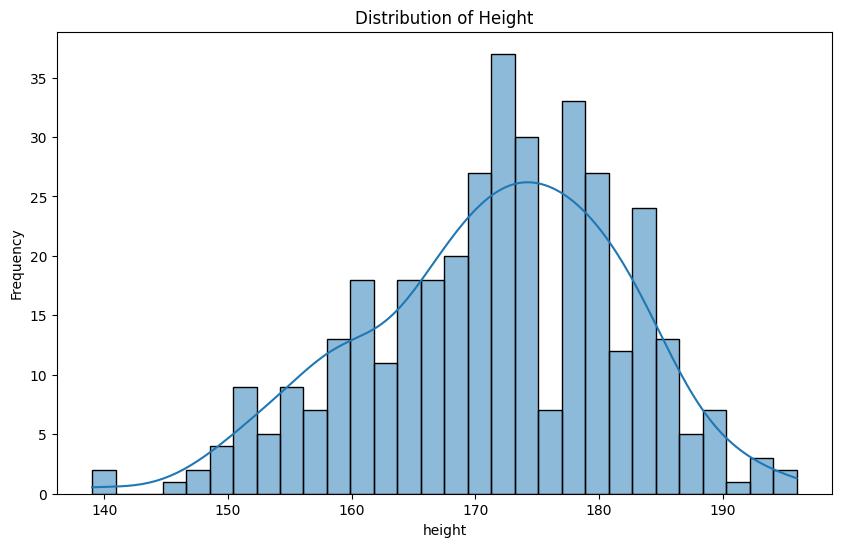

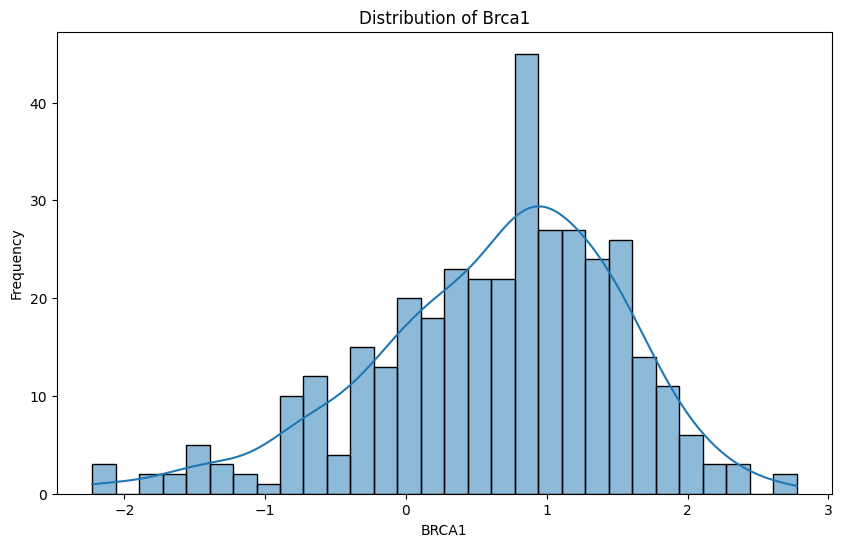

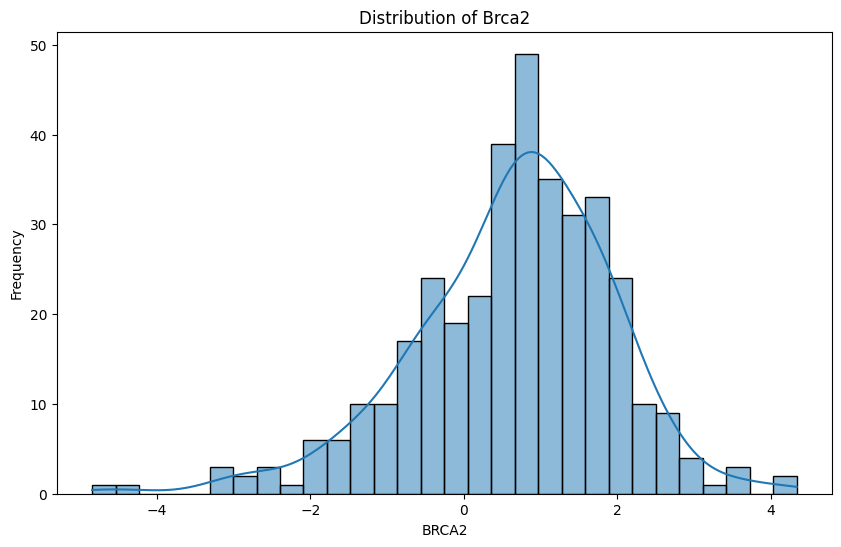

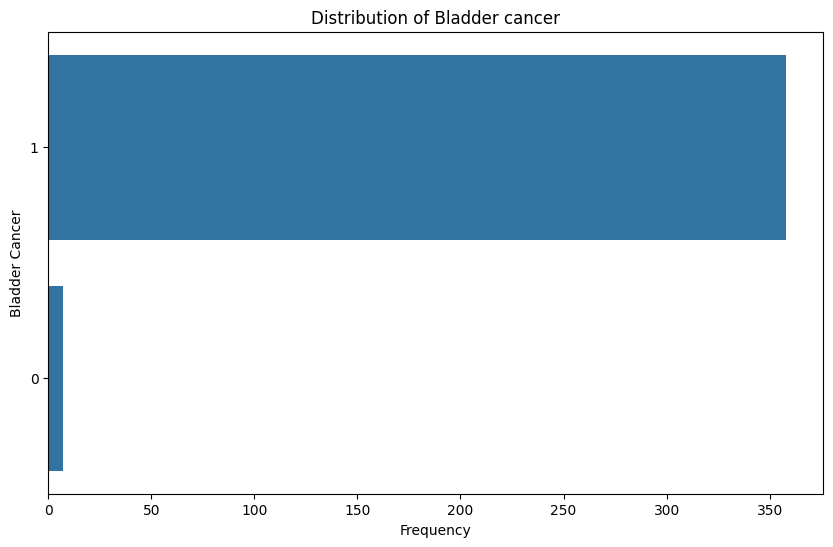

In [15]:
class DataVisualizer:
    def __init__(self, df):
        self.df = df

    def plot_distribution(self, column, numeric=True):
        plt.figure(figsize=(10, 6))
        if numeric:
            sns.histplot(self.df[column], kde=True, bins=30)
            plt.ylabel('Frequency')
        else:
            sns.countplot(y=column, data=self.df, order=self.df[column].value_counts().index)
            plt.xlabel('Frequency')
        plt.title(f'Distribution of {column.capitalize()}')
        plt.show()

    def analyze_distributions(self, numerical_columns, categorical_columns):
        for col in numerical_columns:
            self.plot_distribution(col, numeric=True)

        for col in categorical_columns:
            self.plot_distribution(col, numeric=False)

# Usage
visualizer = DataVisualizer(merged_data)

# For example, choose a few genes you are interested in for visualization:
interested_genes = [col for col in gene_list if 'brca' in col.lower()]
visualizer.analyze_distributions(numerical_columns=[condition_col, *interested_genes], 
                                 categorical_columns=[trait])

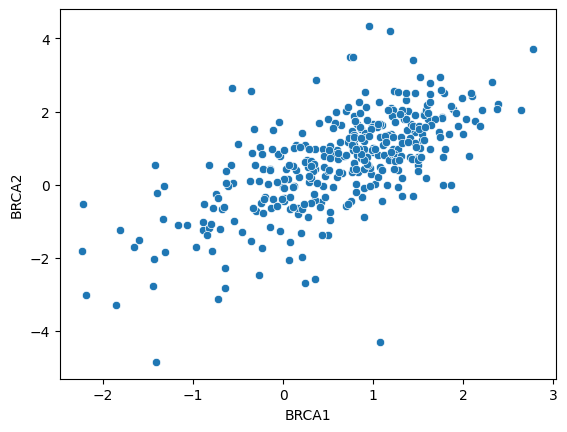

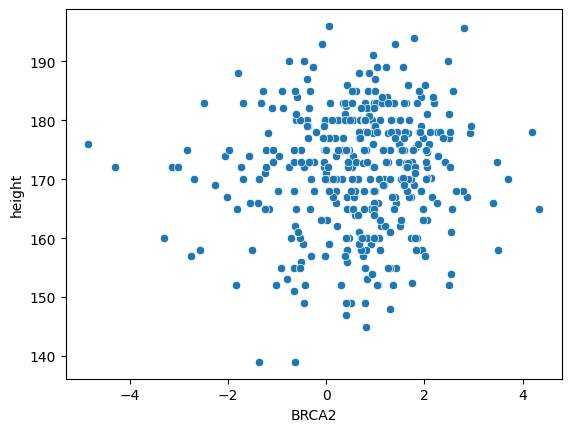

In [16]:
sns.scatterplot(data=merged_data, x='BRCA1', y='BRCA2')
plt.show()

sns.scatterplot(data=merged_data, x='BRCA2', y=condition_col)
plt.show()

### 3. Do regression & Cross Validation

In [17]:

def replace_infinity_with_nan(data):
    """Replace infinity values with NaN."""
    return np.where(np.isinf(data), np.nan, data)

def compute_normalization_params(data):
    """Compute mean and standard deviation, handling zero standard deviation."""
    mean = np.nanmean(data, axis=0)
    std = np.nanstd(data, axis=0)
    std[std <= 1e-8] = 1  # Avoid division by zero
    return mean, std

def normalize_data(data, mean, std):
    """Normalize data using given mean and standard deviation."""
    data_normalized = np.where(np.isnan(data), 0, (data - mean) / std)
    return data_normalized

def preprocess_data(X_train, X_test=None):
    X_train = replace_infinity_with_nan(X_train)
    mean_train, std_train = compute_normalization_params(X_train)

    X_train_normalized = normalize_data(X_train, mean_train, std_train)

    if X_test is not None:
        X_test = replace_infinity_with_nan(X_test)
        X_test[:, std_train <= 1] = 0  # Set zero std columns in test data to zero
        X_test_normalized = normalize_data(X_test, mean_train, std_train)
    else:
        X_test_normalized = None

    return X_train_normalized, X_test_normalized


In [18]:
def split_data(X, y, indices, train_indices, test_indices):
    """Split data into training and testing sets based on indices."""
    X_train, X_test = X[train_indices], X[test_indices]
    y_train, y_test = y[train_indices], y[test_indices]
    return X_train, X_test, y_train, y_test

def train_and_predict(X_train, y_train, X_test):
    """Train the model and make predictions."""
    var_select = VariableSelection()
    var_select.fit(X_train, y_train)
    predictions = var_select.predict(X_test)
    return predictions

def evaluate_accuracy(predictions, y_test):
    """Evaluate the accuracy of predictions."""
    binary_predictions = (predictions > 0.5).astype(int)
    return np.mean(binary_predictions == y_test)

def cross_validation(X, y, k=5):
    indices = np.arange(X.shape[0])
    np.random.shuffle(indices)

    fold_size = len(X) // k
    accuracies = []

    for i in range(k):
        test_indices = indices[i*fold_size : (i+1)*fold_size]
        train_indices = np.setdiff1d(indices, test_indices)

        X_train, X_test, y_train, y_test = split_data(X, y, indices, train_indices, test_indices)
        X_train, X_test = preprocess_data(X_train, X_test)

        predictions = train_and_predict(X_train, y_train, X_test)
        accuracy = evaluate_accuracy(predictions, y_test)
        accuracies.append(accuracy)

    return np.mean(accuracies), np.std(accuracies)

# Select relevant columns and convert to numpy array
y = merged_data[trait].values
X = merged_data.drop(columns=[trait]).values

cv_mean, cv_std = cross_validation(X, y)
print(f'The cross-validation accuracy is {(cv_mean * 100):.2f}% ± {(cv_std * 100):.2f}%')

/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/sparse_lmm/helpingMethods.py:49: RuntimeWarning: invalid value encountered in divide
  ts = beta / np.sqrt(var * sigma)
/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/sparse_lmm/VariableSelection.py:183: RuntimeWarning: divide by zero encountered in log
  return -np.log(p), np.array(betas)


The cross-validation accuracy is 1.92% ± 2.05%


In [ ]:

def prepare_data(merged_data, trait):
    """Prepare and preprocess the dataset."""
    y = merged_data[trait].values
    X = merged_data.drop(columns=[trait]).values
    X, _ = preprocess_data(X)  # Assuming preprocess_data is defined elsewhere
    return X, y

def fit_model(X, y):
    """Fit the VariableSelection model to the data."""
    var_select = VariableSelection()
    var_select.fit(X, y)
    return var_select

def get_model_output(var_select):
    """Retrieve and process the model's output."""
    coefficients = var_select.getBeta().reshape(-1).tolist()
    nlog_p_values = var_select.getNegLogP().reshape(-1).tolist()
    p_values = [np.exp(-p) for p in nlog_p_values]
    return coefficients, p_values

# Main execution
X, y = prepare_data(merged_data, trait)
var_select = fit_model(X, y)
coefficients, p_values = get_model_output(var_select)

### 4. Discussion

In [ ]:
import pandas as pd
from statsmodels.stats.multitest import multipletests


# Create a DataFrame for the regression results
regression_df = pd.DataFrame({
    'Variable': feature_cols,
    'Coefficient': coefficients,
    'p_value': p_values
})

# Extract information about the lifestyle condition's effect
condition_effect = regression_df.iloc[0]

# Report the effect of the lifestyle condition
print(f"Effect of the condition on the target variable:")
print(f"Variable: {condition}")
print(f"Coefficient: {condition_effect['Coefficient']:.4f}")
print(f"p-value: {condition_effect['p_value']:.4g}\n")

In [34]:
threshold = 0.05
# Apply the Benjamini-Hochberg correction
rejected, corrected_p_values, _, _ = multipletests(regression_df['p_value'][1:], alpha=threshold, method='fdr_bh')

# Add the corrected p-values to the DataFrame (ignoring the first row which is the condition)
regression_df.loc[1:, 'corrected_p_value'] = corrected_p_values

# Now filter based on the corrected p-values
significant_genes = regression_df.loc[(regression_df.index > 0) & (regression_df['corrected_p_value'] < threshold)]
significant_genes_sorted = significant_genes.sort_values('corrected_p_value')

# Print and/or save your results as before
print(f"Genes with corrected p-value < {threshold}, affecting the trait {trait} conditional on the factor {condition}, sorted by corrected p-value:")
print(significant_genes_sorted[['Variable', 'Coefficient', 'corrected_p_value']].to_string(index=False))
print(f"\nFound {len(significant_genes_sorted)} significant genes with corrected p-value < {threshold}")
# Save this to a CSV file
significant_genes_sorted.to_csv('significant_genes_report_corrected.csv', index=False)

Genes with corrected p-value < 0.05, affecting the trait Prostate Cancer conditional on the factor weight, sorted by corrected p-value:
  Variable  Coefficient  corrected_p_value
  CSPG4PY2    -0.061389       4.648482e-17
     RBM46    -0.042357       3.285793e-04
    PCNAP1    -0.040300       3.285793e-04
 C17orf105    -0.035428       1.197724e-03
CHKB-CPT1B     0.078773       2.991659e-03
    POU2F1    -0.055591       2.991659e-03
     OR1E1    -0.034155       2.991659e-03
     RBM45     0.062402       2.991659e-03
     HSPA6    -0.050922       2.991659e-03
    OR5AC2    -0.035667       2.991659e-03
      MSH2     0.069004       3.033951e-03
  FLJ46361    -0.035792       3.364777e-03
     GNRH1     0.065842       3.414015e-03
    DEFB4A    -0.038385       3.940022e-03
      LHX5    -0.036952       7.550029e-03
    CHRNB3    -0.033836       9.784952e-03
    SNHG10     0.065109       9.884679e-03
     RUSC1    -0.053562       1.242689e-02
     KRT78    -0.034827       1.242689e-02
    